# Compute universal pattern which makes all detection fail

In [1]:
%load_ext autoreload
%autoreload 2
# imports
import datetime
import logging
import os
import pathlib
import sys

import cv2
import numpy as np
import tensorflow as tf
from matplotlib import pyplot as plt
from tqdm import tqdm

from loss_functions import multi_stage_loss_batch
from plot_utils import gen_plot_universal_noise, plt
from tf_pose.estimator import TfPoseEstimator
from tf_pose.networks import get_graph_path
from utils import print_image_Stats, load_batch


os.environ["TF_CPP_MIN_LOG_LEVEL"] = "3"
logging.getLogger("tensorflow").setLevel(logging.CRITICAL)
logging.getLogger('TfPoseEstimatorRun').setLevel(logging.ERROR)
logging.getLogger('DeepExplain').setLevel(logging.ERROR)
logging.getLogger('TfPoseEstimator').setLevel(logging.ERROR)

/home/ax/miniconda3/envs/masterThesis/lib/python3.6/site-packages/dask/dataframe/utils.py:14: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


The TensorFlow contrib module will not be included in TensorFlow 2.0.
For more information, please see:
  * https://github.com/tensorflow/community/blob/master/rfcs/20180907-contrib-sunset.md
  * https://github.com/tensorflow/addons
  * https://github.com/tensorflow/io (for I/O related ops)
If you depend on functionality not listed there, please file an issue.


Using tf version = 1.15.0


In [2]:
# params 432, 368
w, h = 432, 368

train_dir = '../data/cocoval2017Humans/train'
test_dir = '../data/cocoval2017Humans/test'
model = 'cmu'
log_dir = '../logs/'

resize_out_ratio = 2.0
summary_writer = tf.summary.FileWriter(
    log_dir + "uniInvAdv/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
training_paths = pathlib.Path(train_dir).glob('*.jpg')
training_paths = sorted([x for x in training_paths])
test_paths = pathlib.Path(test_dir).glob('*.jpg')
test_paths = sorted([x for x in test_paths])

In [3]:
estimator = TfPoseEstimator(get_graph_path(
    model), target_size=(w, h), trt_bool=False)
upsample_size = [int(estimator.target_size[1] / 8 * resize_out_ratio),
                 int(estimator.target_size[0] / 8 * resize_out_ratio)]
# get all outputs as np matrix

In [7]:
target_np = np.zeros((1, 46, 54, 57))

In [5]:
EPS = 5000
STEPS = 300
STAGE_INDEX = 6  # range from 2 to 6
BATCH_SIZE = 16

if not "training_stats" in vars():
    # where does the current batch start
    training_stats = {
        'batch_index': 0,
        'image_index': 0,
        'universal_noise': np.zeros((h, w, 3)),
        'file_name': f'../snapshots/op_universal_noise_invisible.npy'
    }

target_heat = tf.compat.v1.placeholder(
    tf.float32, shape=(None, None, None, 19))
target_paf = tf.compat.v1.placeholder(tf.float32, shape=(None, None, None, 38))
grad_func, loss_func = multi_stage_loss_batch(
    estimator, target_heat, target_paf, STAGE_INDEX)

100%|██████████| 300/300 [04:16<00:00,  1.17it/s]


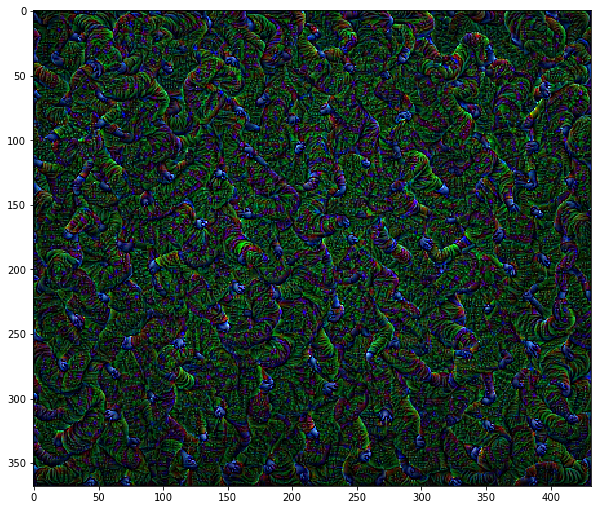

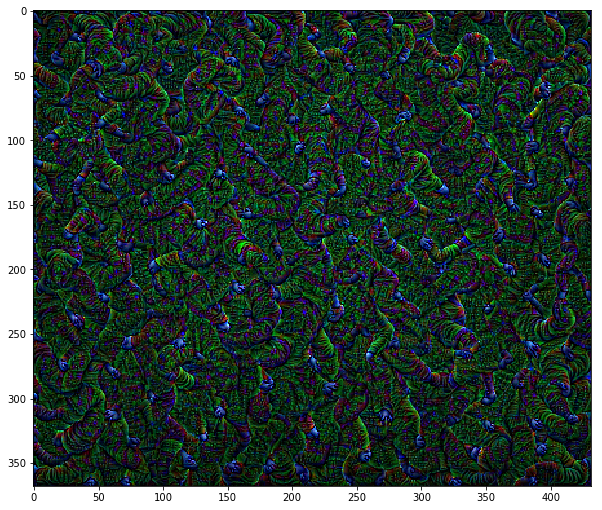

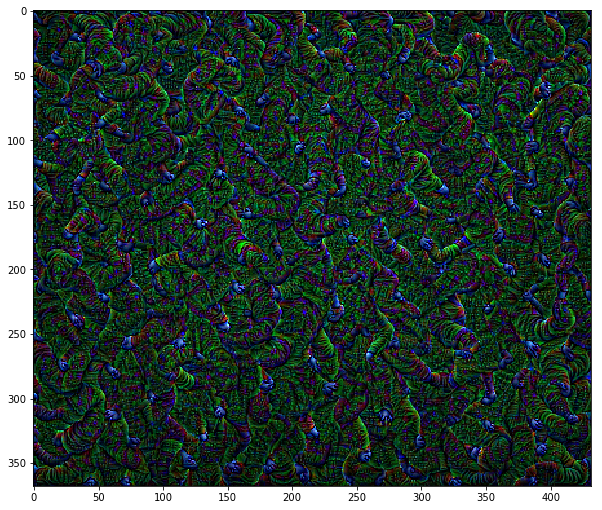

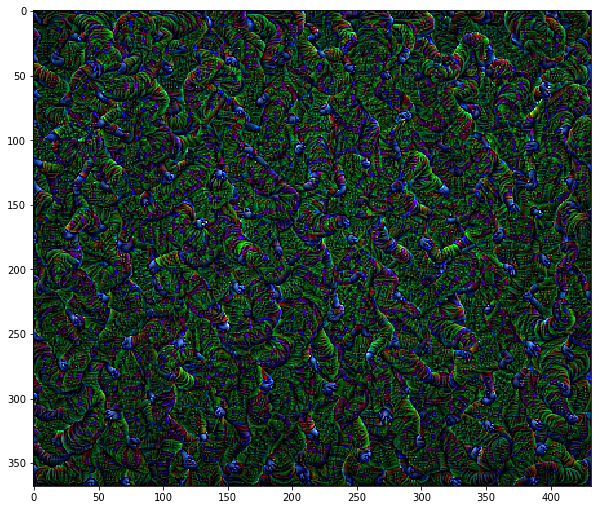

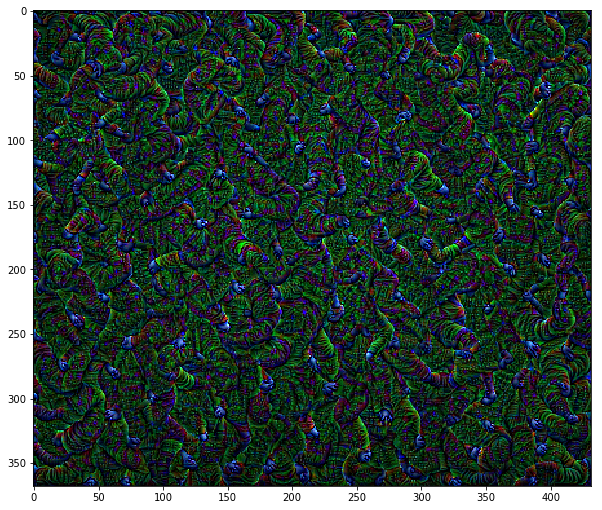

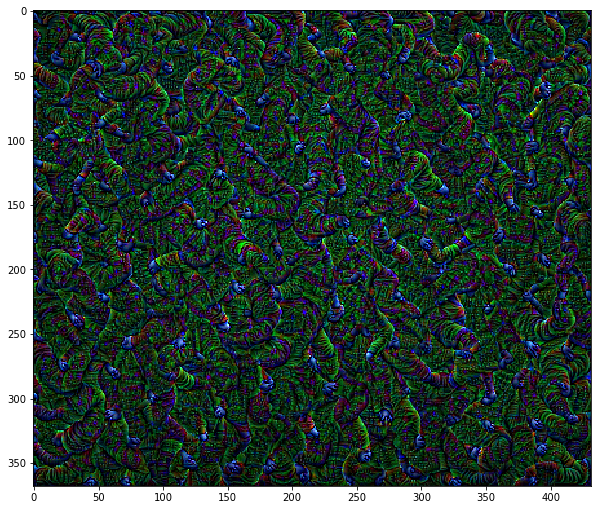

In [7]:
### ================= TRAINING ================= ###

for i in tqdm(range(STEPS)):
    # load a batch
    batch, training_stats['batch_index'] = load_batch(
        training_paths, training_stats['batch_index'], BATCH_SIZE)
    target_heat_batch = np.repeat(target_np[:, :, :, :19], BATCH_SIZE, 0)
    target_paf_batch = np.repeat(target_np[:, :, :, 19:], BATCH_SIZE, 0)

    repeated_noise = np.repeat(np.expand_dims(
        training_stats['universal_noise'], axis=0), BATCH_SIZE, 0)
    batch_with_noise = batch + repeated_noise

    gradient, gn_summ = estimator.persistent_sess.run(
        [grad_func, loss_func],
        feed_dict={
            target_heat: target_heat_batch,
            target_paf: target_paf_batch,
            estimator.tensor_image: batch_with_noise,
            estimator.upsample_size: upsample_size
        }
    )
    summary_writer.add_summary(gn_summ, training_stats['image_index'])

    if i % 50 == 0:
        # Prepare the plot
        plot_buf = gen_plot_universal_noise(training_stats['universal_noise'])

        # Convert PNG buffer to TF image
        tf_image = tf.image.decode_png(plot_buf.getvalue(), channels=4)

        # Add the batch dimension
        tf_image = tf.expand_dims(tf_image, 0)

        # Add image summary
        summary_op = tf.summary.image(
            f"universal_noise_step{training_stats['image_index']}", tf_image)
        summary_img = estimator.persistent_sess.run(summary_op)
        # Write summary

        summary_writer.add_summary(summary_img)
        summary_writer.flush()
    if i % 25 == 0:
        # save universal noise
        np.save(training_stats['file_name'], training_stats['universal_noise'])

    ### ================= UPDATE STEP ================= ###
    #adv_image = adv_image - EPS * np.sign(gradient[0])
    scaled_gradient = (EPS * gradient)
    training_stats['universal_noise'] = training_stats['universal_noise'] - \
        scaled_gradient
    training_stats['universal_noise'] = np.clip(
        training_stats['universal_noise'], 0, 255)

    training_stats['image_index'] += 1


summary_writer.flush()

In [8]:
training_stats['universal_noise'] = np.load(training_stats['file_name'])

Min: 0.0
Max: 255.0
Avg: 34.75304747510011


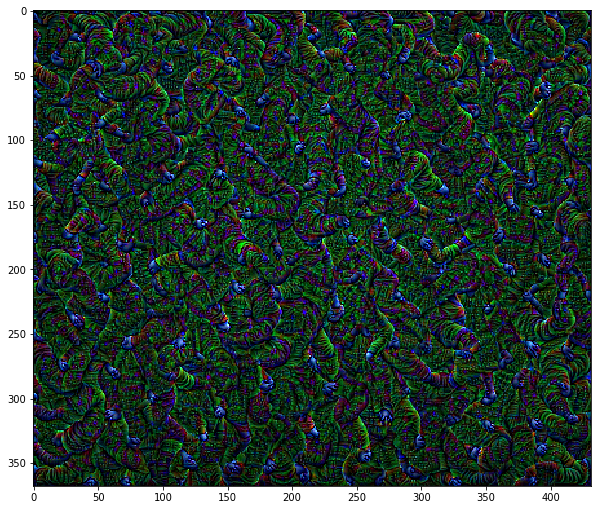

In [10]:
print_image_Stats(training_stats['universal_noise'])
fig = plt.figure(figsize=(10, 10))
ax = fig.add_subplot(1, 1, 1)
ax.imshow(np.clip(training_stats['universal_noise'], 0, 255) / 255)

/home/ax/miniconda3/envs/masterThesis/lib/python3.6/site-packages/ipykernel_launcher.py:19: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


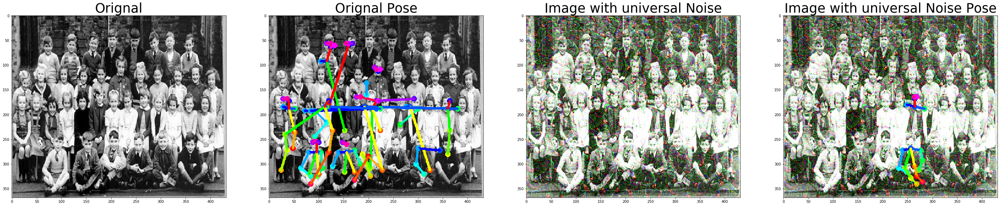

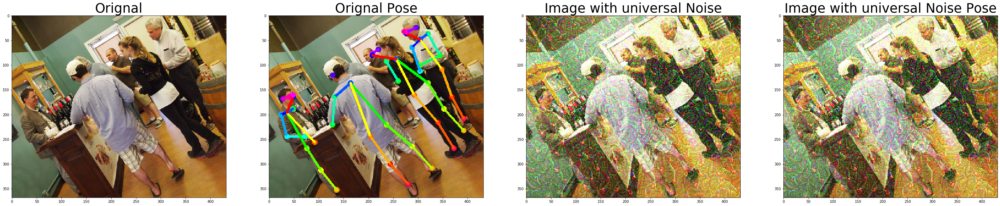

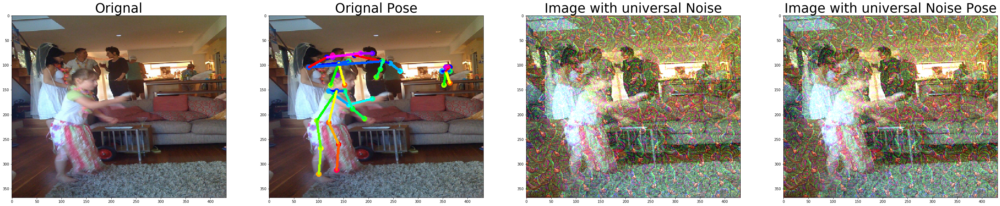

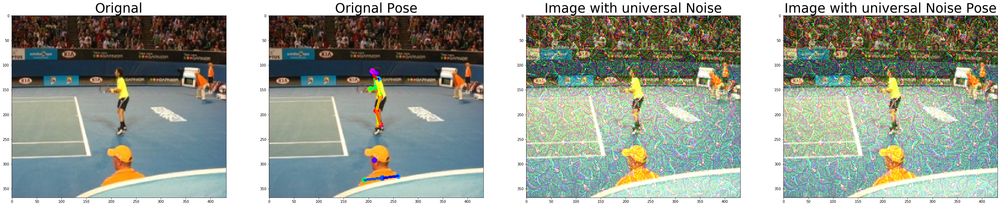

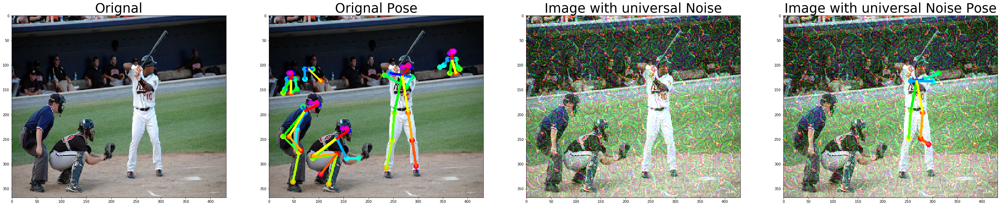

...

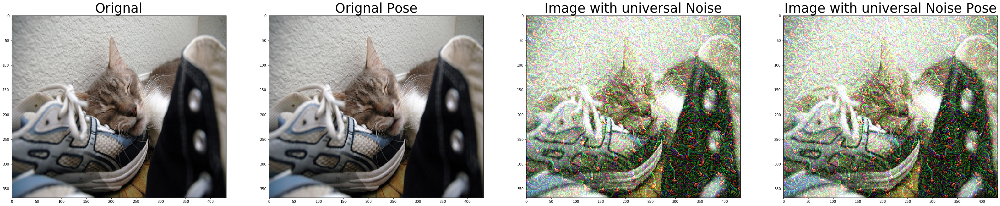

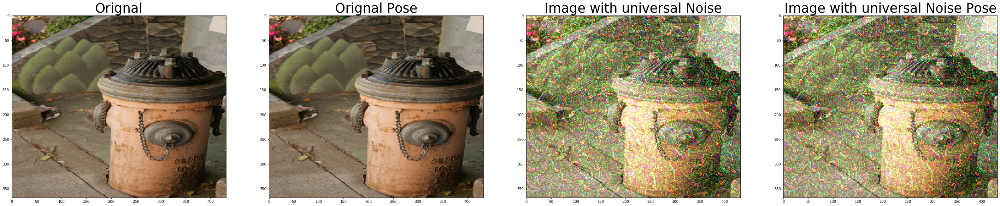

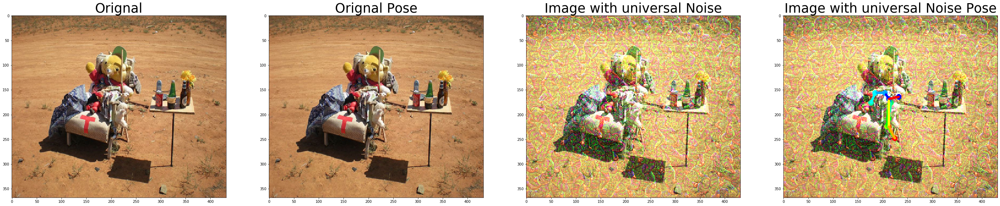

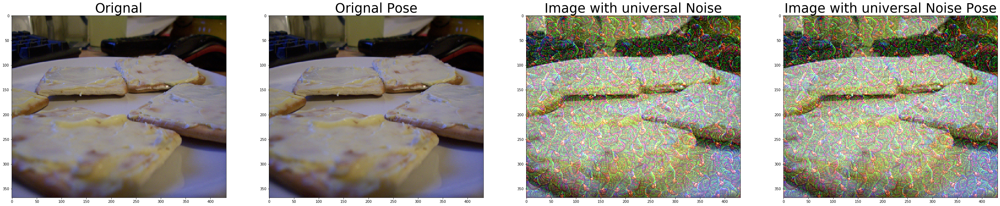

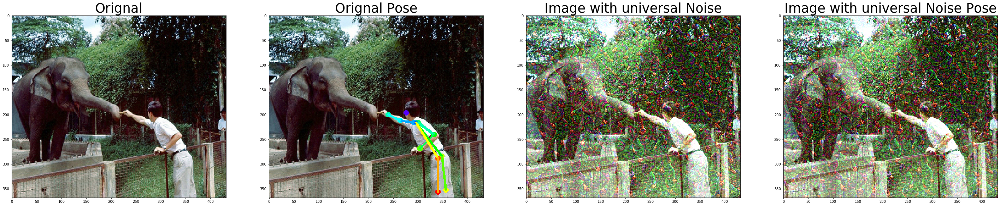

In [11]:
test_batch_size = 21
batch, batch_index = load_batch(test_paths, 0, test_batch_size)
font_size = 37


for i, image in enumerate(batch):
    test_image = np.clip(image + training_stats['universal_noise'], 0, 255)
    detections = estimator.inference(
        image, resize_to_default=True, upsample_size=resize_out_ratio)
    detections_uni = estimator.inference(
        test_image, resize_to_default=True, upsample_size=resize_out_ratio)
    #plot_pose(test_image.astype(np.float32) / 255.0, detections, estimator.heatMat)

    detections_result = TfPoseEstimator.draw_humans(
        image, detections, imgcopy=True)
    detections_uni = TfPoseEstimator.draw_humans(
        test_image, detections_uni, imgcopy=True)

    fig = plt.figure(figsize=(50, 25))
    ax = fig.add_subplot(1, 4, 1)
    ax.set_title('Orignal', fontsize=font_size)
    plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 2)
    ax.set_title('Orignal Pose', fontsize=font_size)
    plt.imshow(cv2.cvtColor(detections_result, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 3)
    ax.set_title('Image with universal Noise', fontsize=font_size)
    plt.imshow(cv2.cvtColor(test_image.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))

    ax = fig.add_subplot(1, 4, 4)
    ax.set_title('Image with universal Noise Pose', fontsize=font_size)
    plt.imshow(cv2.cvtColor(detections_uni.astype(
        np.float32) / 255.0, cv2.COLOR_BGR2RGB))
    fig.savefig(f'../results/plots/universal_noise_test_inv_{i}.png', dpi=100, bbox_inches='tight')